In [1]:
%load_ext autoreload
%autoreload 2
    
import os 
os.environ["CUDA_VISIBLE_DEVICES"] = "3"

import jax.numpy as jnp
import deepxde as dde

from absl import flags
from ml_collections import config_flags, config_dict
from configs.ts import get_config
from bubble_tools.bubble_tools.bubble_ellipsoid_tools import load_ellipse

SAVE_GIF = False

Using backend: pytorch
Other supported backends: tensorflow.compat.v1, tensorflow, jax, paddle.
paddle supports more examples now and is recommended.


In [ ]:
from bubble_tools.bubble_tools.bubble_constants import get_bubble_v2_frame_from_camera_frame
from bubble_tools.bubble_datasets.implemented_datasets.bubble_v2_dataset import BubbleV2Dataset
data_dir = '/data'# Replace this with the path to the data ("/data")
# data_name = 'bubble_v2_tactile_shadowing_data_only_o_45'
data_name = 'bubble_v2_tactile_shadowing_data'

data_path = os.path.join(data_dir, data_name)
dataset = BubbleV2Dataset(data_name=data_path, 
                                    smoothed=True, 
                                    load_cache=False, 
                                    load_trajectories=False, 
                                        load_depth_filtered = True)
SEQ_IDX = 0 # 6, 14

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
Processing the data and saving it to /data/bubble_v2_tactile_shadowing_data/processed_data/bubble_calibration_dataset


  2%|██▋                                                                                                                                                              | 1/60 [00:03<03:48,  3.88s/it]

In [ ]:
from utils import get_dataset

(
    obs_pcd,
    wall_coords,
    outer_coords, 
    E,
    P,
    t, 
    nu,
    a, 
    b,
    L,
    L_e,
    etc,
) = get_dataset(N=20000, SEQ_IDX = SEQ_IDX, data_name = data_name)


E = E / (L **2)   # rubber 0.1 GPa (N/m**2)
P = P / (L **2)
t = t * L# 0.3 mm
a, b = a*L, b*L
wall_coords = wall_coords * L
obs_pcd = obs_pcd * L
outer_coords = outer_coords * L

data_i = dataset[SEQ_IDX]
bubble_pc_bf = obs_pcd

In [ ]:
# Make saving directory
result_dir = f"result/{SEQ_IDX}"
# result_dir = f"result/{SEQ_IDX}"
if not os.path.isdir(result_dir):
    os.mkdir(result_dir)

In [ ]:
from bubble_tools.aux.package_utils import get_mesh_path
from bubble_tools.bubble_shape_tools.shape_tools import load_mesh
from bubble_tools.bubble_tools.bubble_constants import get_bubble_frame_from_camera_frame
from mmint_tools.camera_tools.pointcloud_utils import view_pointcloud, tr_pointcloud
from bubble_tools.bubble_shape_tools.shape_tools import get_bubble_tool_contact_points_sdf
from bubble_tools.bubble_tools.bubble_constants import get_bubble_v2_frame_from_camera_frame

import numpy as np


# Load stl
tool_name = data_i['shape_id']
bubble_pc_cf = data_i['bubble_pointcloud_cf']
w_X_stl = data_i['world_X_stl']
w_X_bcf = data_i['w_X_bcf']
w_X_sf = data_i['w_X_sf']


cf_T_bft = get_bubble_v2_frame_from_camera_frame()
bubble_pc_bcf = tr_pointcloud(bubble_pc_cf[np.newaxis,...], T=  np.linalg.inv(cf_T_bft)).reshape(-1,3)  # (H, W, 3 or 6)



mesh_path = get_mesh_path(f'pressing_shapes/{tool_name}.stl')
tool_mesh = load_mesh(mesh_path)

stl_X_bcf = np.linalg.inv(w_X_stl) @ w_X_bcf
bubble_pc_stl = tr_pointcloud(bubble_pc_cf, T=stl_X_bcf)  # (H, W, 3 or 6)

# Ground Truth Contact
contact_mask_r = get_bubble_tool_contact_points_sdf(bubble_pc_cf[np.newaxis,...], 
                                                        tool_name, 
                                                        w_X_bcf, 
                                                        w_X_sf, 
                                                        contact_threshold=0.0003)


In [ ]:
import numpy as np
import plotly.graph_objects as go

camera_position = (1.0, 0.8, 2.)
camera = dict(
eye=dict(x=0., y=0., z=2.)
)

phi = np.linspace(0, 2*np.pi)
theta = np.linspace(-np.pi/2, np.pi/2)
phi, theta=np.meshgrid(phi, theta)

x = np.cos(theta) * np.sin(phi) * 0.06
y = np.cos(theta) * np.cos(phi) * 0.04
z = np.sin(theta) * 0.001

# bubble frame (bf)
layout = go.Layout(
             scene=dict(
                 aspectmode='data'
         ))

fig = go.Figure(data=[go.Scatter3d(x =bubble_pc_bf[:,0], 
                                y = bubble_pc_bf[:,1], 
                                z = bubble_pc_bf[:,2], 
                                   mode="markers",
                                marker=dict(size=2, 
                                            color =bubble_pc_bf[:,2]/L,
                                            colorscale='earth', opacity=1.0,
                                            colorbar=dict(thickness=20)),
                               ),
                 go.Scatter3d(
                    x=wall_coords[:,0],
                    y=wall_coords[:,1],
                    z=wall_coords[:,2],
                    mode="markers", 
                    marker=dict(size=1, color='black', opacity=0.5))], layout=layout
               )


camera_position_hor = (1.0, 0.8, 2.)
camera_hor = dict(
eye=dict(x=0., y=2.5, z=0.)
)

fig.update_layout( width=800,height=800, showlegend=False, scene_camera=camera_hor, autosize = False)

fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
# fig.update_xaxes(automargin=False, range=[-0.06,0.06]) 
# fig.update_yaxes(automargin=False, range=[-0.06,0.06])
# fig.update_xaxes(
#     scaleanchor = "x",
#     scaleratio = 1,
# )

fig.write_image(f"{result_dir}/def_hor_{SEQ_IDX}.png")
fig.show()



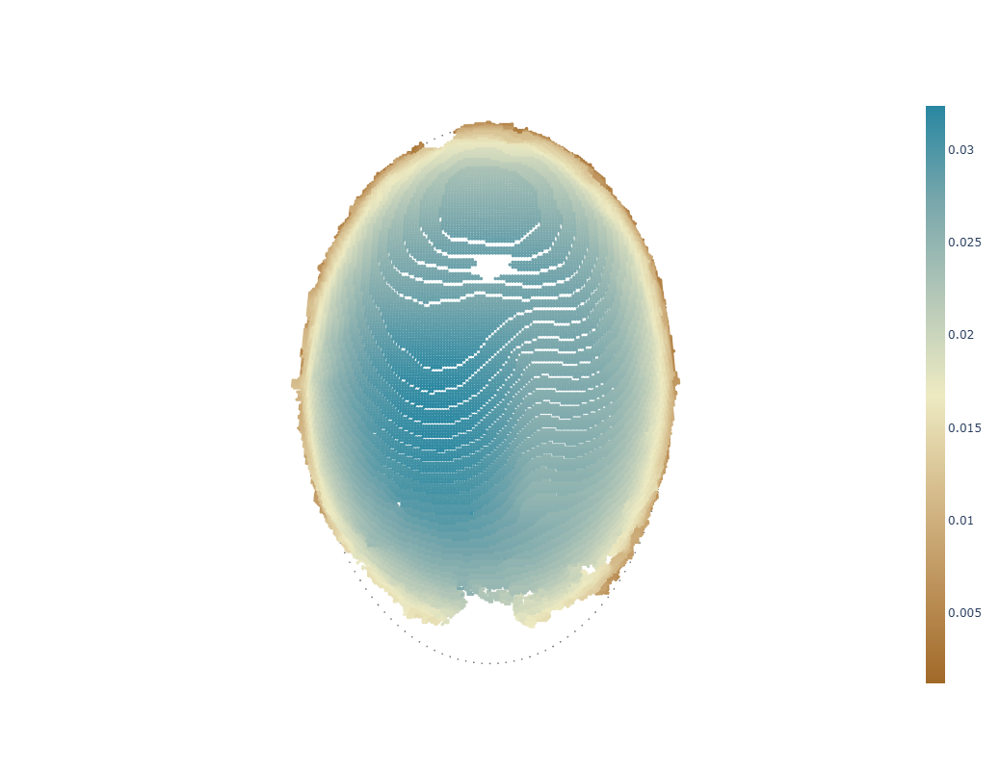

In [13]:
import numpy as np
import plotly.graph_objects as go

phi = np.linspace(0, 2*np.pi)
theta = np.linspace(-np.pi/2, np.pi/2)
phi, theta=np.meshgrid(phi, theta)

x = np.cos(theta) * np.sin(phi) * 0.06
y = np.cos(theta) * np.cos(phi) * 0.04
z = np.sin(theta) * 0.001

# bubble frame (bf)
layout = go.Layout(
             scene=dict(
                 aspectmode='data'
         ))

fig = go.Figure(data=[go.Scatter3d(x =bubble_pc_bf[:,0], 
                                y = bubble_pc_bf[:,1], 
                                z = bubble_pc_bf[:,2], 
                                   mode="markers",
                                marker=dict(size=2, 
                                            color =bubble_pc_bf[:,2]/L,
                                            colorscale='earth', opacity=1.0,
                                            colorbar=dict(thickness=20)),
                               ),
                 go.Scatter3d(
                    x=wall_coords[:,0],
                    y=wall_coords[:,1],
                    z=wall_coords[:,2],
                    mode="markers", 
                    marker=dict(size=1, color='black', opacity=0.5))], layout=layout
               )



fig.update_layout( width=800,height=800, showlegend=False, scene_camera=camera, autosize = False)

fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
# fig.update_xaxes(automargin=False, range=[-0.06,0.06]) 
# fig.update_yaxes(automargin=False, range=[-0.06,0.06])
# fig.update_xaxes(
#     scaleanchor = "x",
#     scaleratio = 1,
# )

fig.write_image(f"{result_dir}/def_{SEQ_IDX}.png")
fig.show()



In [25]:
from plotly_gif import GIF, three_d_scatter_rotate
if SAVE_GIF:
    gif = GIF(mode="buffer")
    three_d_scatter_rotate(gif, fig, viewer_position = (2.0, 0.8, 0.85), frames = 30)
    gif.create_gif(gif_path=f'{result_dir}/def_{SEQ_IDX}.gif', duration = 100)

In [15]:
bubble_pc_bcf.shape, contact_mask_r.shape

((40398, 3), torch.Size([1, 40398]))

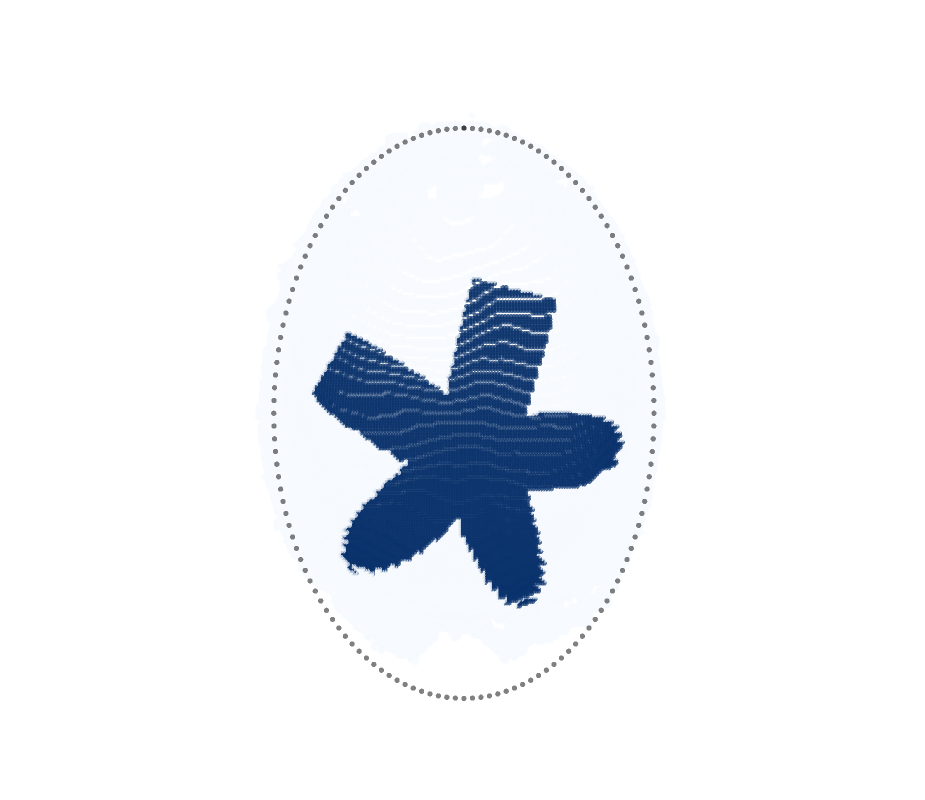

In [20]:
fig = go.Figure(data=[go.Scatter3d(
        x=bubble_pc_bcf.reshape(-1, 3)[:,0]*L,
        y=bubble_pc_bcf.reshape(-1, 3)[:,1]*L,
        z=bubble_pc_bcf.reshape(-1, 3)[:,2]*L,
        mode="markers", 
        marker=dict(size=3, color=contact_mask_r.reshape(-1)*255., opacity=0.7, colorscale='blues'),
    ),
     go.Scatter3d(
        x=wall_coords[:,0],
        y=wall_coords[:,1],
        z=wall_coords[:,2],
        mode="markers", 
        marker=dict(size=3, color='black', opacity=0.5),
    )], layout=layout)
fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
fig.update_layout(width=800, height=800, scene_camera=camera, showlegend=False)
fig.update_xaxes(automargin=False) 
fig.update_yaxes(automargin=False)
fig.show()
fig.write_image(f"{result_dir}/gt_{SEQ_IDX}.png")


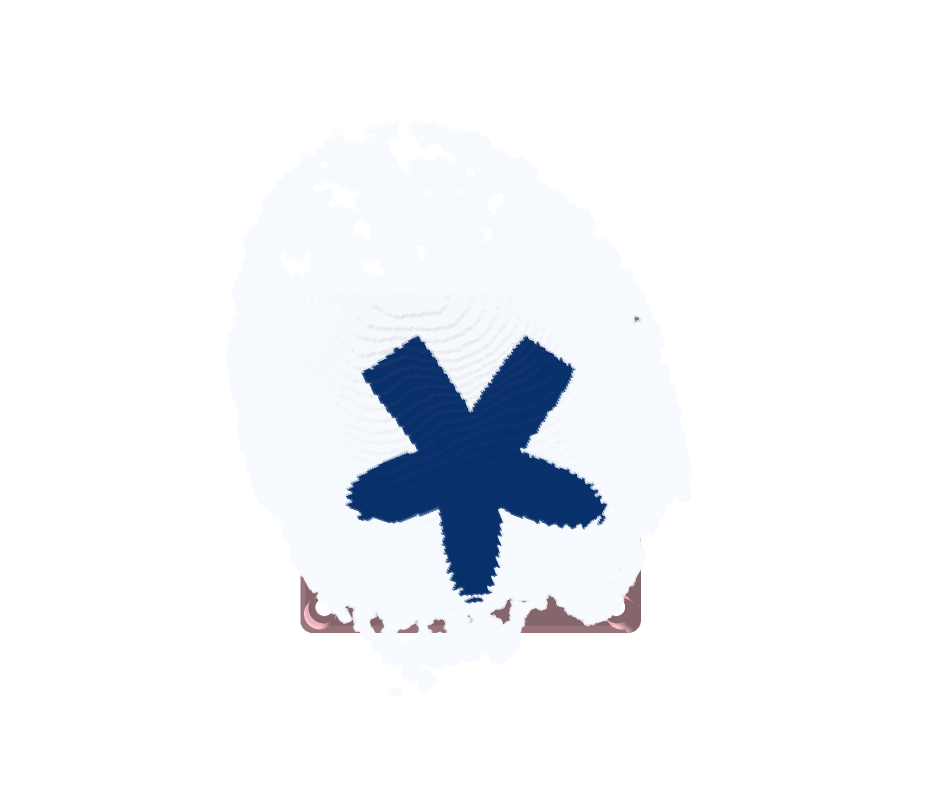

In [31]:
# Visualization of the ground truth contact mask
# Visualization of the current observation
from bubble_tools.bubble_shape_tools.shape_tools import get_bubble_tool_contact_points_sdf

vertices = np.array(tool_mesh.vertices) * 0.001 # [mm] -> [m]
faces = np.array(tool_mesh.triangles)
fig = go.Figure(data=[go.Mesh3d(x = vertices[:,0], 
                                y = vertices[:,1], 
                                z = vertices[:,2], 
                                i = faces[:,0],
                                j = faces[:,1],
                                k = faces[:,2],
                                color='pink', 
                                opacity=0.8, lighting=dict(ambient=0.5)
                               )])




fig.add_trace(
    go.Scatter3d(
        x=bubble_pc_stl.reshape(-1, 3)[:,0],
        y=bubble_pc_stl.reshape(-1, 3)[:,1],
        z=bubble_pc_stl.reshape(-1, 3)[:,2],
        mode="markers", 
        marker=dict(size=3, color=contact_mask_r.reshape(-1)*255., opacity=0.7, colorscale='blues'),
    )
)
camera_image =(0, 0, 3.)
fig.update_xaxes(automargin=False) 
fig.update_yaxes(automargin=False)
fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
fig.update_layout(width=800, height=800, scene_camera=camera)
fig.show()

In [44]:
from bubble_tools.bubble_tools.bubble_constants import get_bubble_v2_frame_from_camera_frame

def scatter_rotate_2opacity(mesh, pcd, opacities = [(0.8, 0.5), ( 0.7, 0.9) ], colorscale = 'reds', additional_mesh = [], camera_position = (1.0, 0.8, 2.) ):
    gif_ori = GIF(mode="buffer")
    gif_ori.imgs = []
    for i in range(2):
        if i == 1:
            mesh_opacity, pcd_opacity = opacities[0]
        else:
            mesh_opacity, pcd_opacity = opacities[1]

        
        
        vertices = np.array(mesh.vertices) * 0.001 # [mm] -> [m]
        faces = np.array(mesh.triangles)

        data = []

        for add_mesh_i in additional_mesh:
            vertices_i = np.array(add_mesh_i.vertices) # [mm] -> [m]
            faces_i = np.array(add_mesh_i.triangles)
        
            data.append(
               go.Mesh3d(x = vertices_i[:,0], 
                        y = vertices_i[:,1], 
                        z = vertices_i[:,2], 
                        i = faces_i[:,0],
                        j = faces_i[:,1],
                        k = faces_i[:,2],
                    )
                )


        
        fig = go.Figure(data=data + [go.Mesh3d(x = vertices[:,0], 
                                        y = vertices[:,1], 
                                        z = vertices[:,2], 
                                        i = faces[:,0],
                                        j = faces[:,1],
                                        k = faces[:,2],
                                        color='pink', 
                                        opacity=mesh_opacity, lighting=dict(ambient=0.5)
                                       )])

        fig.add_trace(
            go.Scatter3d(
                x=pcd[:,0],
                y=pcd[:,1],
                z=pcd[:,2],
                mode="markers", 
                marker=dict(size=1, color=pcd[:,3], opacity=pcd_opacity,
                            colorscale=colorscale, colorbar=dict(thickness=20)),          
            )
        )
        if wrench_w is not None:
            fig.update_layout(title = dict(text= f"Wrench magnitude gt:{ round(wrench_w, 2)}[N], est:{round(np.double(cnt_fc), 3)}[N]", x=0.5))

        fig.update_layout(width=600, height=600)
        fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )

        gif = GIF(mode="buffer")
        three_d_scatter_rotate(gif, fig, viewer_position = camera_position, frames = 30)
        gif_ori.imgs =  gif_ori.imgs + gif.imgs
    return gif_ori
        

In [13]:
if SAVE_GIF:
    wrench_w, cnt_fc = None, None
    gif = scatter_rotate_2opacity(tool_mesh, 
                                  np.concatenate([bubble_pc_stl, contact_mask_r.reshape(-1,1)*255.], axis = 1), 
                                  opacities = [(0.8, 0.1), ( 0.7, 0.6)] , colorscale = 'blues')    
    gif.create_gif(gif_path=f'{result_dir}/gt_{SEQ_IDX}.gif', duration = 100)

## Inverse Problem Result Visualization

In [32]:
# Restore Model
import models
from jaxpi.utils import restore_checkpoint

config = get_config()
CONFIG_NAME = 'configs/ts.py'
# ckpt_path = os.path.join(".", "ckpt", CONFIG_NAME)

model = models.Membrane(
        config,
        wall_coords,
        obs_pcd,
        outer_coords,
        E, P, t, nu, a, b, L, L_e,
    )
ckpt_path = os.path.join(".", "ckpt", result_dir[7:])
# ckpt_path = os.path.join(".", "ckpt", f"{SEQ_IDX}")

model.state = restore_checkpoint(model.state, ckpt_path)
params = model.state.params



Restore checkpoint  ./ckpt/0 at step  30000


In [33]:
import numpy as np
u_pred = model.u_pred_fn(params, outer_coords[:,0], outer_coords[:,1])
v_pred = model.v_pred_fn(params, outer_coords[:,0], outer_coords[:,1])
w_pred = model.w_pred_fn(params, outer_coords[:,0], outer_coords[:,1])
f_pred = model.f_pred_fn(params, outer_coords[:,0], outer_coords[:,1])
# f_pred = -model.r_nf_pred_fn(params, outer_coords[:,0], outer_coords[:,1])

f_pred = np.clip(f_pred, 0., np.inf)
s = (outer_coords[2,0] - outer_coords[1,0]) #/L # pointcloud should be ordered

# Convert back the scale
x_hat = outer_coords[:, 0]/L + u_pred/L
y_hat = outer_coords[:, 1]/L + v_pred/L
z_hat = w_pred/L

pcd = np.concatenate([x_hat[..., np.newaxis],
                      y_hat[..., np.newaxis],
                      z_hat[..., np.newaxis]], axis = 1)

import matplotlib.cm as cm
color = cm.viridis(f_pred/max(f_pred))[..., :3]


In [34]:
# Ground truth wrench
wrench_w = np.linalg.norm(np.array(data_i['wrench_w'][:3])) # (N, 6)

# s = (outer_coords[2,0] - outer_coords[1,0])/L # pointcloud should be ordered
cnt_fc = np.sum(f_pred) * s**2
wrench_w, cnt_fc

(11.429175309519762, Array(9.729071, dtype=float32))

In [37]:
from scipy.interpolate import griddata
import numpy as np

#Define a regular grid over the data
xr = np.linspace(-0.06, 0.06, 120)
yr= np.linspace(-0.04, 0.04, 80)
xr, yr = np.meshgrid(xr, yr)

#evaluate the z-values at the regular grid through cubic interpolation
Z = griddata((x_hat, y_hat), f_pred * L**2, (xr, yr))

Z_cnt = griddata((bubble_pc_bcf.reshape(-1, 3)[:,0], 
                  bubble_pc_bcf.reshape(-1, 3)[:,1]), 
                 contact_mask_r.reshape(-1)*255, (xr, yr))

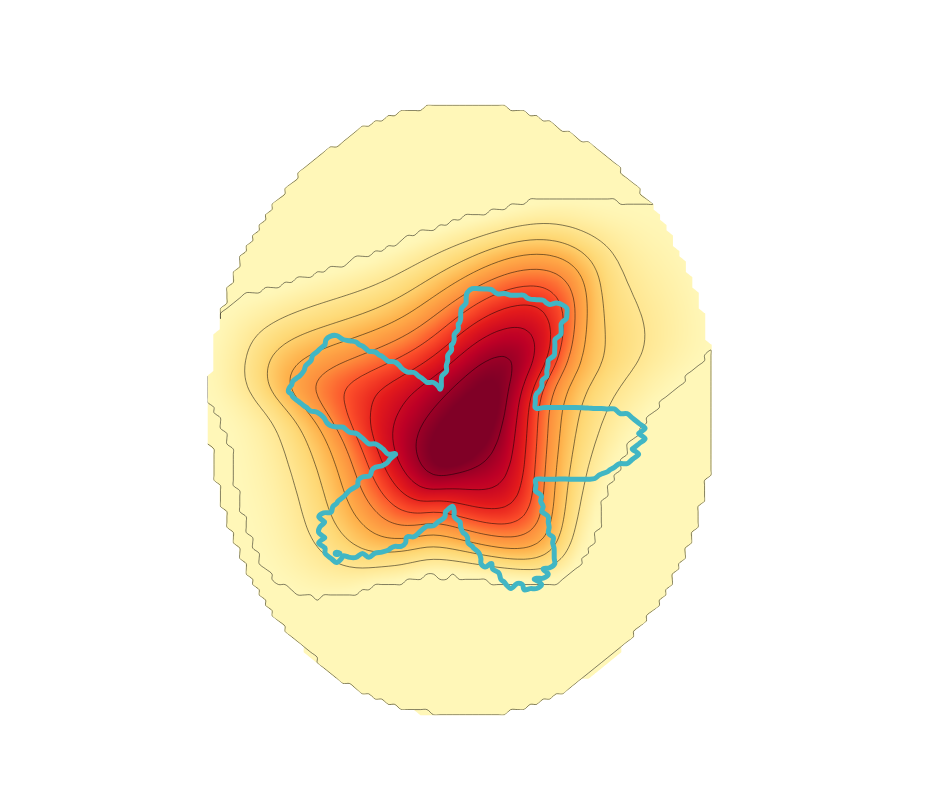

In [38]:
import plotly.graph_objects as go
from plotly.graph_objs import Layout
layout = Layout(
    # paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)'
)
fig = go.Figure(data=[go.Contour(y=xr[0], 
                                 x=-yr[:, 0], 
                                 z=np.transpose(Z), 
                                 contours=dict(start=0, end=8000, size=1000),
                                 contours_coloring='heatmap',
                                 colorscale='YlOrRd'),
                        go.Contour(y=xr[0], 
                                 x=-yr[:, 0], 
                                 z=np.transpose(Z_cnt), 
                                 contours=dict(start=-200, end=350, size=255), 
                                contours_coloring='lines', 
                                 line_width=5,
                                colorscale='YlGnBu'),
                       # go.Contour(y=xr[0], 
                       #           x=-yr[:, 0], 
                       #           z=np.transpose(cnt_est_real), 
                       #           contours=dict(start=-200, end=350, size=255), 
                       #          contours_coloring='lines', 
                       #           line_width=5,
                       #          colorscale='Reds')
                     ],
               layout = layout)   
fig.update_layout(width=800, height=800,  
                  xaxis = dict(nticks=4, range=[-0.06,0.06],),  
                  yaxis = dict(nticks=4, range=[-0.06,0.06],),)
fig.update_xaxes(automargin=False) 
fig.update_yaxes(automargin=False)
fig.update_traces(showscale=False)

fig.update_xaxes(showticklabels=False) # Hide x axis ticks 
fig.update_yaxes(showticklabels=False)

fig.write_image(f"{result_dir}/cnt_contour_{SEQ_IDX}.png")

fig.show()     

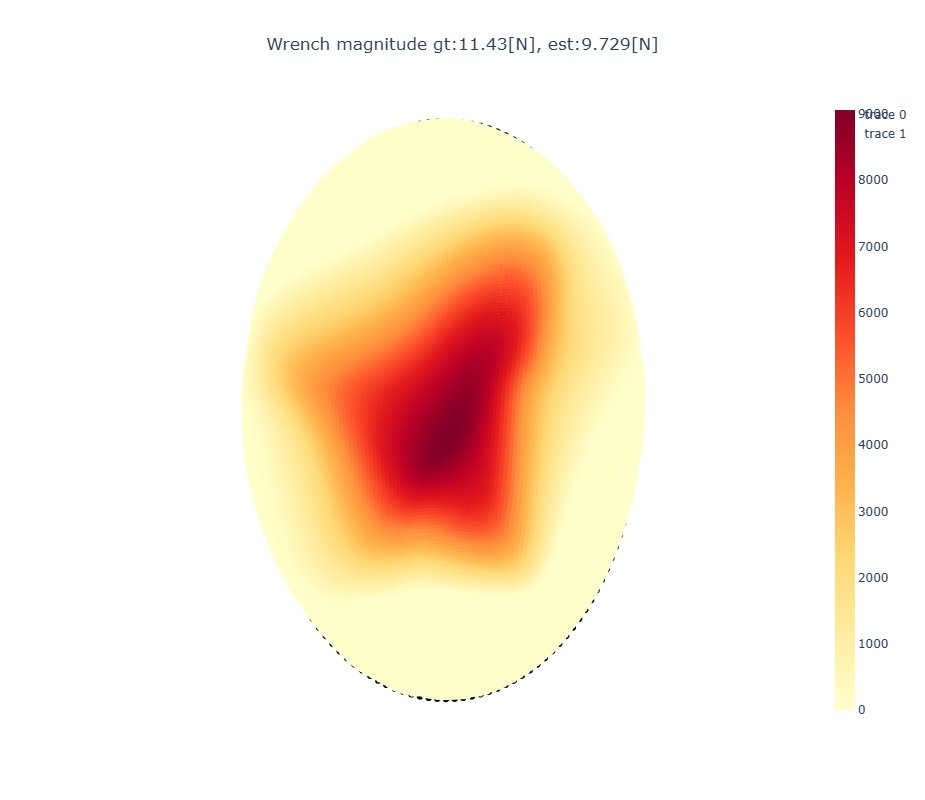

In [40]:
import plotly.graph_objects as go

# Download data set from plotly repo

vertices = np.array(tool_mesh.vertices) * 0.001 # [mm] -> [m]
faces = np.array(tool_mesh.triangles)
fig = go.Figure(data=[ go.Scatter3d(
        x=pcd[:,0],
        y=pcd[:,1],
        z=pcd[:,2],
        mode="markers", 
        marker=dict(size=3., color=f_pred * L**2, opacity=1.0,
                    colorscale='YlOrRd', colorbar=dict(thickness=20)),          
    ),
    go.Scatter3d(
        x=wall_coords[:,0]/L,
        y=wall_coords[:,1]/L,
        z=wall_coords[:,2]/L,
        mode="markers", 
        marker=dict(size=4, color='black', opacity=1.0),
    )
                     
                     ])


fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
fig.update_layout(title = dict(text= f"Wrench magnitude gt:{ round(wrench_w, 2)}[N], est:{round(np.double(cnt_fc), 3)}[N]", x=0.5))
fig.update_layout(width=800, height=800, scene_camera=camera)


# from plotly_gif import GIF, three_d_scatter_rotate
# if SAVE_GIF:
#     gif = GIF(mode="buffer")
#     three_d_scatter_rotate(gif, fig, viewer_position = (2.0, 0.8, 0.85), frames = 30)
#     gif.create_gif(gif_path=f'{result_dir}/cnt_{SEQ_IDX}.gif', duration = 100)

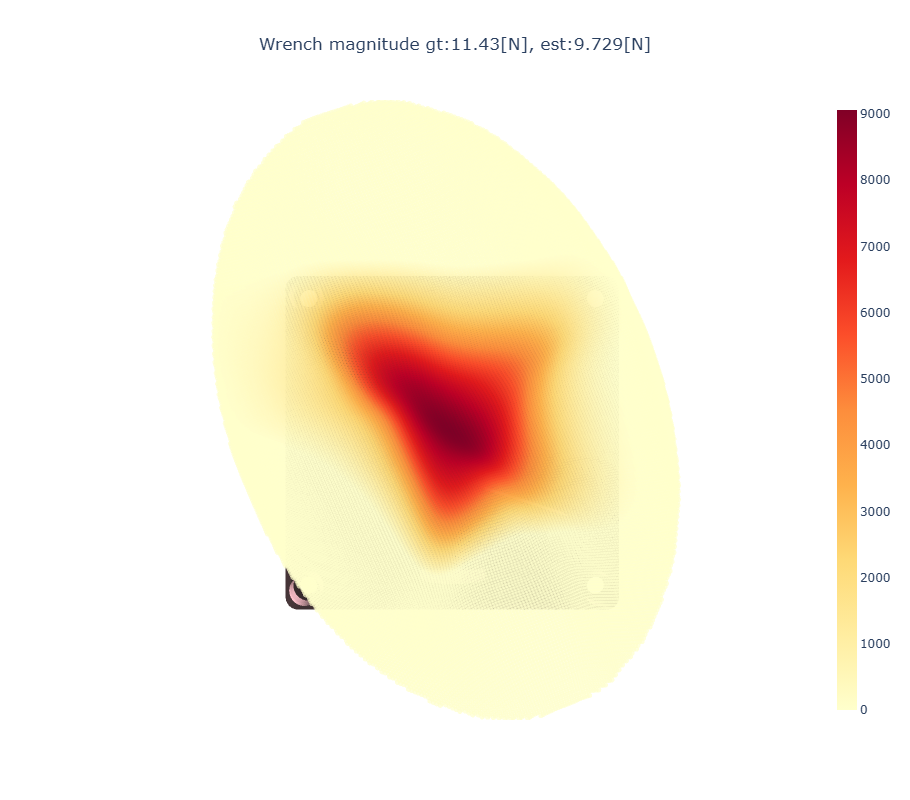

In [41]:
import plotly.graph_objects as go

# Download data set from plotly repo
vertices = np.array(tool_mesh.vertices) * 0.001 # [mm] -> [m]
faces = np.array(tool_mesh.triangles)
fig = go.Figure(data=[go.Mesh3d(x = vertices[:,0], 
                                y = vertices[:,1], 
                                z = vertices[:,2], 
                                i = faces[:,0],
                                j = faces[:,1],
                                k = faces[:,2],
                                color='pink', 
                                opacity=0.9, lighting=dict(ambient=0.2)
                               )])


from bubble_tools.bubble_tools.bubble_constants import get_bubble_v2_frame_from_camera_frame
cf_T_bft = get_bubble_v2_frame_from_camera_frame()

stl_X_bcf = np.linalg.inv(w_X_stl) @ w_X_bcf
pcd_world_frame = tr_pointcloud(pcd[np.newaxis,...], T= stl_X_bcf @ cf_T_bft).reshape(-1,3)  # (H, W, 3 or 6)
fig.add_trace(
    go.Scatter3d(
        x=pcd_world_frame[:,0],
        y=pcd_world_frame[:,1],
        z=pcd_world_frame[:,2],
        mode="markers", 
        marker=dict(size=3., color=f_pred * L**2, opacity=0.7,
                    colorscale='YlOrRd', colorbar=dict(thickness=20)),          
    )
)
fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
fig.update_layout(title = dict(text= f"Wrench magnitude gt:{ round(wrench_w, 2)}[N], est:{round(np.double(cnt_fc), 3)}[N]", x=0.5))
fig.update_layout(width=800, height=800, scene_camera=camera)


In [42]:
import trimesh

# Load stl
bubble_mesh_path = get_mesh_path(f'bubble_v2_palm.stl')
bubble_mesh = load_mesh(bubble_mesh_path)
bubble_vertices = np.asarray(bubble_mesh.vertices)/1000
bubble_faces = np.asarray(bubble_mesh.triangles)


tool_mesh_no_base = trimesh.load_mesh(mesh_path)
tool_mesh_no_base = tool_mesh_no_base.slice_plane([0,0,0], [0, 0, 1])
faces_no_base = np.asarray(tool_mesh_no_base.faces)

In [45]:
from plotly_gif import GIF, three_d_scatter_rotate

cf_T_bft = get_bubble_v2_frame_from_camera_frame()
pcd_world_vis = np.concatenate([pcd_world_frame, f_pred.reshape(-1,1)], axis = 1)
gif = scatter_rotate_2opacity(tool_mesh, pcd_world_vis, colorscale = 'YlOrRd')    
gif.create_gif(gif_path=f'{result_dir}/cnt_ovl_{SEQ_IDX}.gif', duration = 150)

In [19]:
from mmint_tools import tr, pose_to_matrix, matrix_to_pose, transform_matrix_inverse
import open3d as o3d

stl_X_bubble_frame =  pose_to_matrix( np.array([0, 0, -0.0045, 1., 0, 0, 0]))  #as (x,y,z, qx, qy,qz, qw)
bubble_vertices_transformed = tr_pointcloud(bubble_vertices, T=stl_X_bubble_frame)  # (H, W, 3 or 6)
bubble_mesh.vertices = o3d.utility.Vector3dVector(bubble_vertices_transformed)

# Tool mesh from the bubble frame
# tool_mesh_bf = tr_pointcloud(np.array(tool_mesh.vertices)/1000, T= np.linalg.inv(w_X_bcf) @ w_X_stl)  # (H, W, 3 or 6)
tool_mesh_no_base.vertices = tr_pointcloud(np.array(tool_mesh_no_base.vertices)/1000, T= tr.inverse_matrix(cf_T_bft) @ tr.inverse_matrix(stl_X_bcf) )  # (H, W, 3 or 6)
tool_mesh_no_base.vertices[:,2] +=0.005
tool_mesh_bf = tool_mesh_no_base.vertices


# color - remove the bottom plate
idx = np.where(vertices[:,2] < 0.0)
vertexcolor = np.ones((len(vertices), 4))
vertexcolor[idx,3] = 0.1

idx = np.where(vertices[:,2] < 0.0)
vertexcolor = np.ones((len(vertices), 4))
vertexcolor[idx,3] = 0.1

facecolor  = np.ones((len(faces), 4))

In [29]:
obs_pcd_world = tr_pointcloud(bubble_pc_bf[np.newaxis,...]/L, T= stl_X_bcf @ cf_T_bft).reshape(-1,3)  # (H, W, 3 or 6)

In [18]:
fig = go.Figure(data=[
                        go.Mesh3d(x = bubble_vertices_transformed[:,0], 
                                y = bubble_vertices_transformed[:,1], 
                                z = bubble_vertices_transformed[:,2], 
                                i = bubble_faces[:,0],
                                j = bubble_faces[:,1],
                                k = bubble_faces[:,2], 
                                # vertexcolor = vertexcolor, lighting=dict(ambient=0.1),
                               ),
                      go.Mesh3d(x = tool_mesh_bf[:,0], 
                                y = tool_mesh_bf[:,1], 
                                z = tool_mesh_bf[:,2], 
                                i = faces_no_base[:,0],
                                j = faces_no_base[:,1],
                                k = faces_no_base[:,2], color = 'pink',
                                # vertexcolor = vertexcolor, lighting=dict(ambient=0.01, roughness=0.9) 
                                    # facecolor = facecolor, lighting=dict(ambient=0.01, roughness=0.9) 

                               ),
                      # go.Scatter3d(
                      #           x=pcd[:,0],
                      #           y=pcd[:,1],
                      #           z=pcd[:,2],
                      #           mode="markers", 
                      #           marker=dict(size=2., color=f_pred * L**2, opacity=0.5,
                      #                       colorscale='YlOrRd', colorbar=dict(thickness=20)),          
                      #       )
                      go.Scatter3d(
                                x=bubble_pc_bf[:,0]/L,
                                y=bubble_pc_bf[:,1]/L,
                                z=bubble_pc_bf[:,2]/L,
                                mode="markers", 
                                marker=dict(size=2., opacity=0.5),          
                            )                     
                     
                     ])
scale = 1.5
camera = dict(
eye=dict(x=-1.0/scale, y=2./scale, z=2.0/scale)
)
fig.update_xaxes(automargin=False) 
fig.update_yaxes(automargin=False)
fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
fig.update_layout(width=800, height=800, scene_camera=camera)
fig.write_image(f"{result_dir}/full_view_{SEQ_IDX}.png")
fig.show()

NameError: name 'bubble_vertices_transformed' is not defined

In [ ]:
import copy
tool_mesh_no_base_ = copy.copy(tool_mesh_no_base)
tool_mesh_no_base_.vertices *= 1000

gif = scatter_rotate_2opacity(tool_mesh_no_base_.as_open3d, 
                              np.concatenate([pcd, f_pred.reshape(-1,1) * L**2], axis = 1), 
                              colorscale = 'YlOrRd', 
                              additional_mesh = [bubble_mesh],
                              opacities = [(1.0, 0.5), ( 0.1, 0.5) ],
                              camera_position =( -1.0/scale, 2./scale, 2.0/scale) )    
gif.create_gif(gif_path=f'{result_dir}/full_view_{SEQ_IDX}.gif', duration = 100)

In [ ]:
import open3d as o3d
pcd_o3d = o3d.geometry.PointCloud()
pcd_o3d.points = o3d.utility.Vector3dVector(pcd_world_frame)
o3d.io.write_point_cloud('result/pcd_world.ply', pcd_o3d)

np.save(f'{result_dir}/contact_pressure_est_{SEQ_IDX}.npy', f_pred)
np.save(f'{result_dir}/contact_wrench_gt_{SEQ_IDX}.npy', data_i['wrench_w'])


## Save all the results

In [14]:
#evaluate the z-values at the regular grid through cubic interpolation
Z = np.nan_to_num(Z)
Z_cnt = np.nan_to_num(Z_cnt)


# Contact Mask Prediction
p_thres = 2.5e3 # TODO: This is tunable
cnt_est_real = np.where( Z < p_thres, np.zeros_like(Z), np.ones_like(Z))
Z_cnt_real = np.where( Z_cnt == 0, np.zeros_like(Z_cnt), np.ones_like(Z_cnt))


1081 3421 870


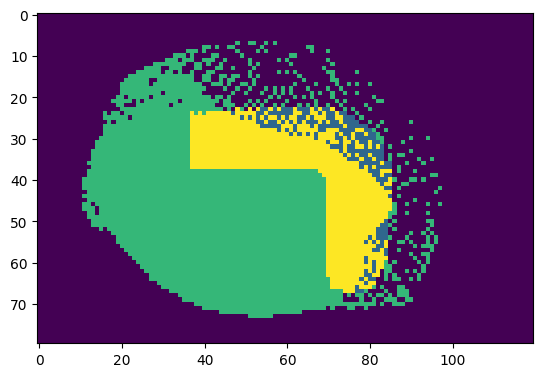

Array(0.23953743, dtype=float32)

In [15]:
def binary_mask_iou(mask1, mask2):
    mask1_area = jnp.count_nonzero(mask1)
    mask2_area = jnp.count_nonzero(mask2)
    intersection = jnp.count_nonzero(jnp.logical_and(mask1, mask2))
    iou = intersection / (mask1_area + mask2_area - intersection)
    print(mask1_area,mask2_area ,intersection)
    return iou
    
iou = binary_mask_iou (Z_cnt_real,  cnt_est_real)


import matplotlib.pyplot as plt
plt.imshow(Z_cnt_real+cnt_est_real*2)
plt.savefig(f"{result_dir}/iou_{SEQ_IDX}.png")
plt.show()

iou

1081 3374 826


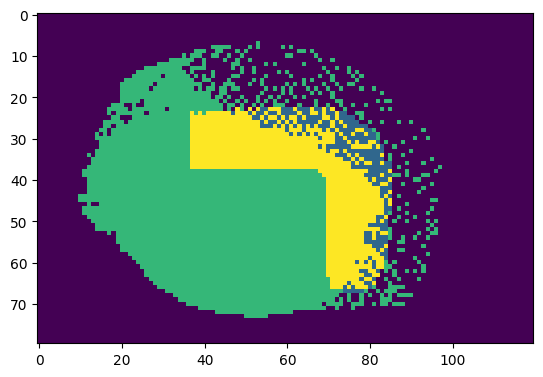

Array(0.22761092, dtype=float32)

In [19]:
def binary_mask_iou(mask1, mask2):
    mask1_area = jnp.count_nonzero(mask1)
    mask2_area = jnp.count_nonzero(mask2)
    intersection = jnp.count_nonzero(jnp.logical_and(mask1, mask2))
    iou = intersection / (mask1_area + mask2_area - intersection)
    print(mask1_area,mask2_area ,intersection)
    return iou
    
iou = binary_mask_iou (Z_cnt_real,  cnt_est_real)


import matplotlib.pyplot as plt
plt.imshow(Z_cnt_real+cnt_est_real*2)
plt.savefig(f"{result_dir}/iou_{SEQ_IDX}.png")
plt.show()

iou

In [35]:
import csv
from pathlib import Path

result = "result/summary.csv"
result_file = Path(result)
fieldnames = ['IDX', 'log path', 'object', 'wrench gt', 'wrench est', 'wrench error', 'p_thres', 'IoU']

if result_file.is_file(): 
    with open(result, newline='') as csvfile:
        reader = csv.DictReader(csvfile)
        for row in reader:
            print(row)

else:
    with open(result, 'w', newline='') as csvfile:
        writer = csv.writer(csvfile)
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
        writer.writeheader()
        
with open(result, 'a', newline='') as csvfile:  
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writerow({'IDX': SEQ_IDX, 
                     'log path':ckpt_path, 
                     'object': tool_name, 
                     'wrench gt': wrench_w, 
                     'wrench est': cnt_fc, 
                     'wrench error': abs( wrench_w - cnt_fc), 
                     "p_thres": p_thres, 
                     'IoU':iou})
        

{'1': '2', './ckpt/1': './ckpt/2', 'y_shape': 'half_cylinder_r20', '8.958210604468594': '10.571094747017986', '10.122303': '11.783887', '1.1640921': '1.2127924', '2500.0': '2500.0', '0.582458': '0.5124378'}
{'1': '3', './ckpt/1': './ckpt/3', 'y_shape': '90_curve', '8.958210604468594': '8.782054342447822', '10.122303': '7.4103003', '1.1640921': '1.3717537', '2500.0': '2500.0', '0.582458': '0.5317073'}
{'1': '4', './ckpt/1': './ckpt/4', 'y_shape': 'o_45', '8.958210604468594': '6.783510697298957', '10.122303': '4.347812', '1.1640921': '2.4356985', '2500.0': '2500.0', '0.582458': '0.27065217'}
{'1': '5', './ckpt/1': './ckpt/5', 'y_shape': 'round_cross_r10_90deg', '8.958210604468594': '8.977005755221713', '10.122303': '5.403266', '1.1640921': '3.57374', '2500.0': '2500.0', '0.582458': '0.6148981'}
{'1': '6', './ckpt/1': './ckpt/6', 'y_shape': 'flower', '8.958210604468594': '11.465078862526164', '10.122303': '10.607997', '1.1640921': '0.85708237', '2500.0': '2500.0', '0.582458': '0.62959796'